In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

#Ejemplo 1

In [ ]:
def logistic_map(r, x):
    return r * x * (1 - x)

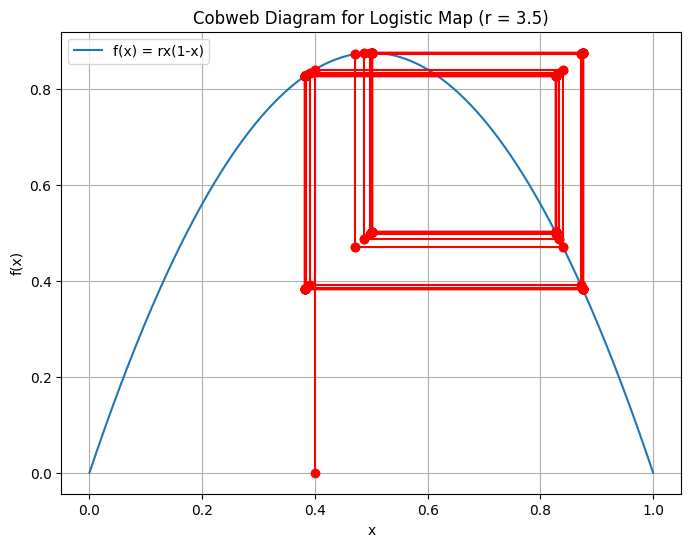

In [ ]:
# Parameters
r = 3.5  # Growth parameter
iterations = 50
x_range = np.linspace(0, 1, 500)  # Range of x values for the cobweb diagram

# Initial point
x_initial = 0.4

# Initialize the cobweb diagram
plt.figure(figsize=(8, 6))
plt.plot(x_range, logistic_map(r, x_range), label="f(x) = rx(1-x)")
plt.plot([x_initial, x_initial], [0, logistic_map(r, x_initial)], 'ro-')  # Initial point
x = x_initial

# Generate cobweb diagram points
for _ in range(iterations):
    y = logistic_map(r, x)
    plt.plot([x, y], [y, y], 'ro-')
    plt.plot([y, y], [y, logistic_map(r, y)], 'ro-')
    x = y

plt.title(f"Cobweb Diagram for Logistic Map (r = {r})")
plt.xlabel("x")
plt.ylabel("f(x)")
plt.legend()
plt.grid(True)
plt.show()

#Ejemplo 2

In [ ]:
def cobweb_animation(f, x0, iterations=50):
    # Define the function f and its range
    def func(x):
        return f(x)

    # Generate x values and their corresponding f(x) values
    x_vals = np.linspace(0, 1, 400)
    y_vals = func(x_vals)

    # Initialize the plot
    fig, ax = plt.subplots()
    ax.plot(x_vals, y_vals, label='y = f(x)')
    ax.plot(x_vals, x_vals, label='y = x', linestyle='dashed')
    ax.set_xlabel('x')
    ax.set_ylabel('f(x)')
    ax.set_title('Cobweb Diagram')
    ax.legend()

    line, = ax.plot([], [], 'ro-', label='Iteration Path')
    iteration_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

    x = x0
    data = [(x, 0)]

    def init():
        line.set_data([], [])
        iteration_text.set_text('')
        return line, iteration_text

    def update(frame):
        nonlocal x
        if frame > 0:
            x_prev, y_prev = data[frame - 1]
            y = func(x_prev)
            data.append((x_prev, y))
            data.append((y, y))
            x = y

        line.set_data(*zip(*data))
        iteration_text.set_text(f'Iteration: {frame}')
        return line, iteration_text

    ani = FuncAnimation(fig, update, frames=iterations, init_func=init, blit=True, repeat=False)
    ani

# Example usage
def quadratic_map(x):
    return 3.9 * x * (1 - x)

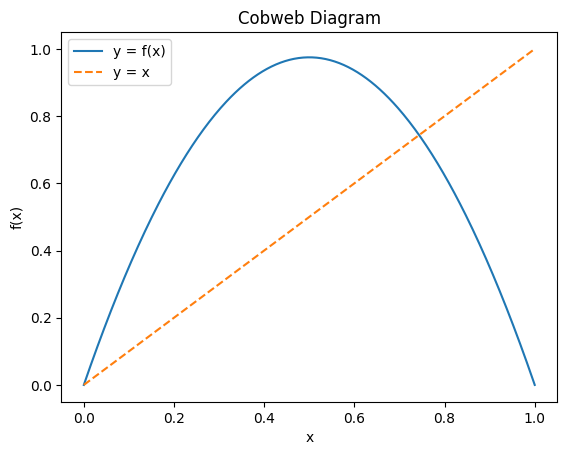

In [ ]:
cobweb_animation(quadratic_map, 0.2, iterations=30)

#Ejemplo 3

In [ ]:
def cobweb_plot(f, x0, num_iterations=20):
    # Create a range of x values for plotting
    x_values = np.linspace(min(x0, f(x0)), max(x0, f(x0)), 100)

    # Generate the function values
    y_values = f(x_values)

    # Create the plot
    plt.figure(figsize=(8, 6))
    plt.plot(x_values, y_values, label='f(x)')
    plt.plot(x_values, x_values, label='y=x', linestyle='dashed')

    x = x0
    for i in range(num_iterations):
        y = f(x)

        # Plot the lines connecting points
        plt.plot([x, x], [x, y], color='red', linestyle='dotted')
        plt.plot([x, y], [y, y], color='blue', linestyle='dotted')

        x = y

    plt.title('Cobweb Diagram')
    plt.xlabel('x')
    plt.ylabel('f(x)')
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
def functionF(x):
    #return -3/4 * x - 1
    return 3.2 * x * (1-x)

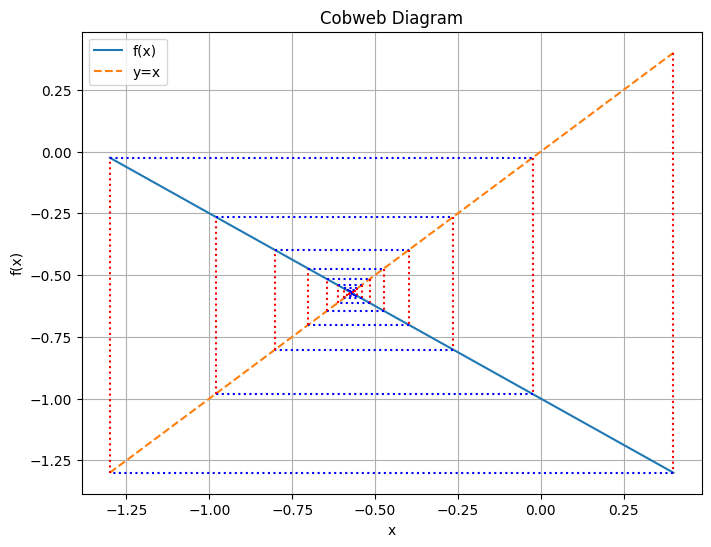

In [ ]:
cobweb_plot(functionF, 0.4)

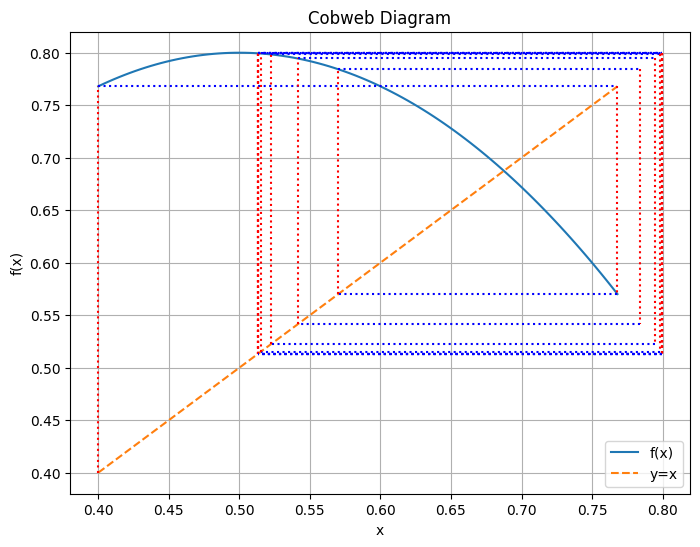

In [ ]:
cobweb_plot(functionF, 0.4)

#Ejemplo 4

In [ ]:
def cobweb(f, x0, iterations):
    # plot the function being iterated
    t = np.linspace(0, 1, 100)
    #t = np.linspace(0, 1, iterations)
    plt.plot(t, f(t), 'k')

    # plot the dotted line y = x
    plt.plot(t, t, "k:")

    lista = []
    lista.append([x0,0])
    #lista.append([x0,f(x0)])

    # plot the iterates
    x, y = x0, f(x0)
    for _ in range(iterations):
        fy = f(y)

        #Movimiento horizontal
        plt.plot([x, y], [y, y], 'b', linewidth=1)
        lista.append([x,y])
        lista.append([y,y])

        #Movimiento vertical
        plt.plot([y, y], [y, fy], 'b', linewidth=1)
        #lista.append([y,y])
        lista.append([y,fy])

        x, y = y, fy

    plt.show()

    return lista

In [ ]:
def movement(lista):
  listaAux1 = []
  listaAux2 = []
  listaMov = []
  for i in range(len(lista)):
    if (i+1) < len(lista):
      if lista[i][0] != lista[i+1][0] or lista[i][1] != lista[i+1][1]:
        if lista[i][0] != lista[i+1][0]:
          listaAux1.extend( np.linspace(lista[i][0], lista[i+1][0] , 10) )
          listaAux2.extend( [lista[i][1]] * 10 )
        else:
          listaAux2.extend( np.linspace(lista[i][1], lista[i+1][1] , 10) )
          listaAux1.extend( [lista[i][0]] * 10 )
  for i in range(len(listaAux1)):
    listaMov.append( [listaAux1[i], listaAux2[i]] )
  return listaMov

##Fun ejemplo

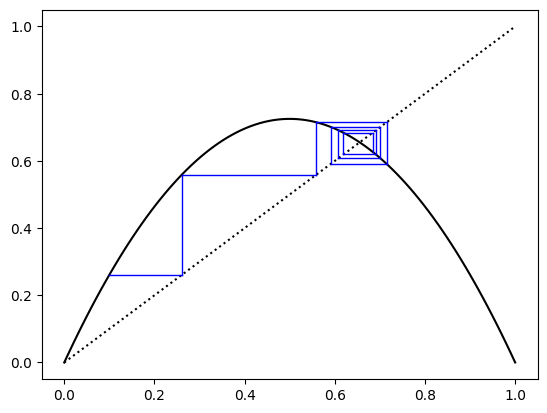

In [ ]:
# one fixed point
listaPuntos = cobweb(lambda x: 2.9*x*(1-x), 0.1, 9)

In [ ]:
listOfPuntos = movement(listaPuntos)

In [ ]:
f = lambda x : x

In [ ]:
fun = lambda x: 2.9*x*(1-x)

In [ ]:
x = np.linspace(0,1,100)

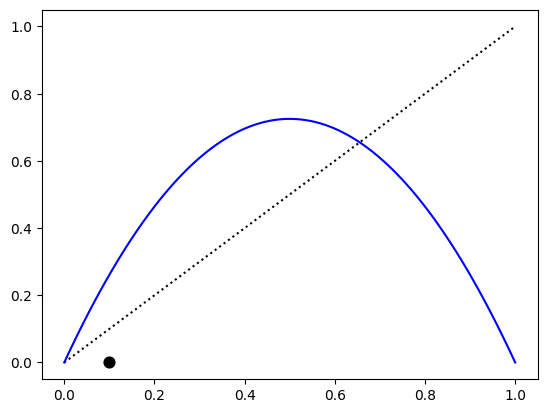

In [ ]:
fig, axes = plt.subplots()
axes.plot(x, f(x),  'k:')
axes.plot(x, fun(np.linspace(0,1,100)), color='blue')

canvas  = axes.scatter(0.1, 0, color='black', edgecolors='black', s=60)

In [ ]:
plt.rc('animation', html='jshtml')

def update(frame, canvas, x):
    canvas.set_offsets((x[frame][0], x[frame][1] ))
    return canvas

ani = FuncAnimation(fig=fig, func=update, fargs=(canvas, listOfPuntos), frames=len(listOfPuntos), interval=50)

ani

##Fun 1

In [ ]:
f = lambda x : x

In [ ]:
x = np.linspace(0,1,100)

In [ ]:
fun1 = lambda x : -3/4 * (x - 1)

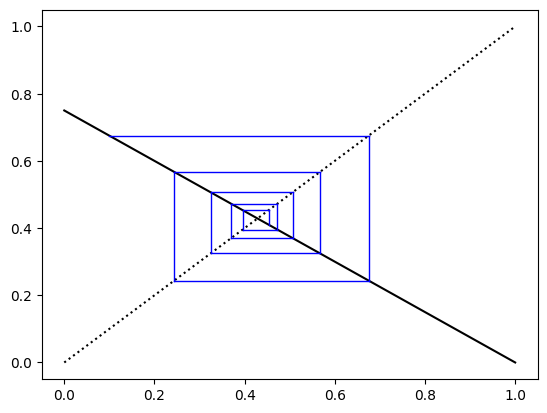

In [ ]:
listaPuntos1 = cobweb(fun1, 0.1, 9)

In [ ]:
listMov1 = movement(listaPuntos1)

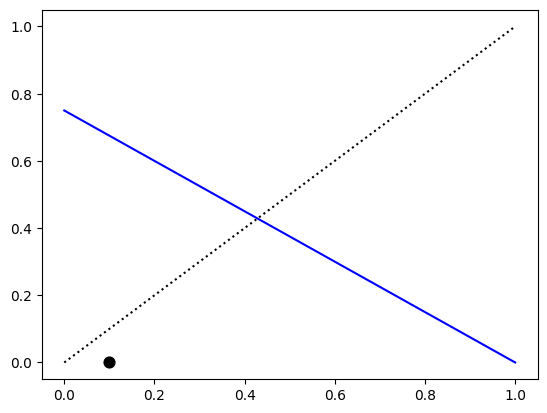

In [ ]:
fig, axes = plt.subplots()
axes.plot(x, f(x),  'k:')
axes.plot(x, fun1(np.linspace(0,1,100)), color='blue')

canvas  = axes.scatter(0.1, 0, color='black', edgecolors='black', s=60)

In [ ]:
plt.rc('animation', html='jshtml')

def update(frame, canvas, x):
    canvas.set_offsets((x[frame][0], x[frame][1] ))
    return canvas

ani = FuncAnimation(fig=fig, func=update, fargs=(canvas, listMov1), frames=len(listMov1), interval=50)

ani

##Func 2

In [ ]:
fun2 = lambda x : 3.2 * x * (1-x)

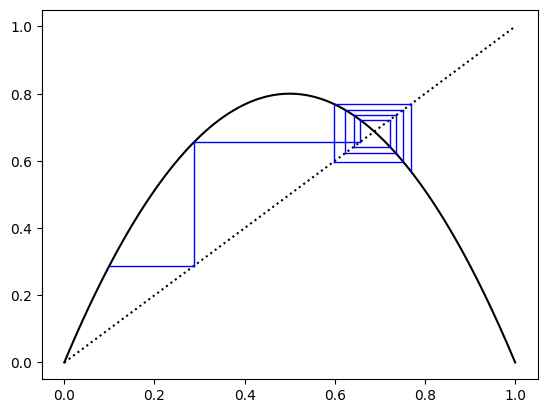

In [ ]:
listaPuntos2 = cobweb(fun2, 0.1, 9)

In [ ]:
listMov2 = movement(listaPuntos2)

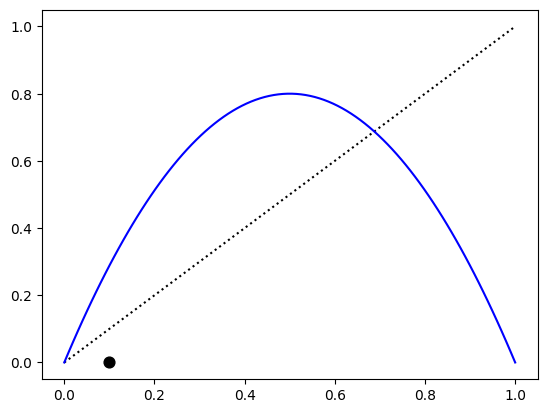

In [ ]:
fig, axes = plt.subplots()
axes.plot(x, f(x),  'k:')
axes.plot(x, fun2(np.linspace(0,1,100)), color='blue')

canvas  = axes.scatter(0.1, 0, color='black', edgecolors='black', s=60)

In [ ]:
plt.rc('animation', html='jshtml')

def update(frame, canvas, x):
    canvas.set_offsets((x[frame][0], x[frame][1] ))
    return canvas

ani = FuncAnimation(fig=fig, func=update, fargs=(canvas, listMov2), frames=len(listMov2), interval=50)

ani